# Тестирование оригинального датасета

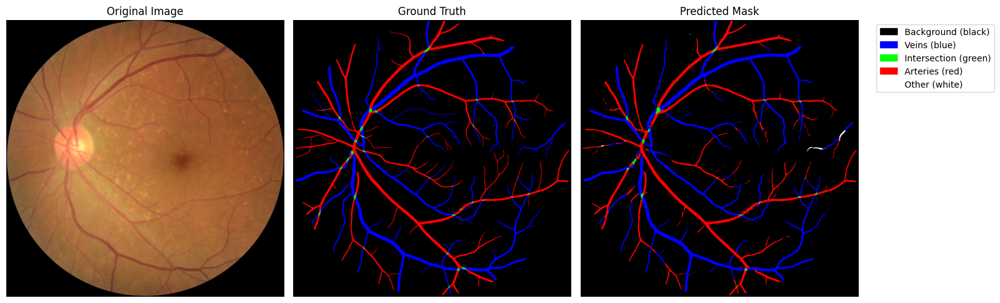

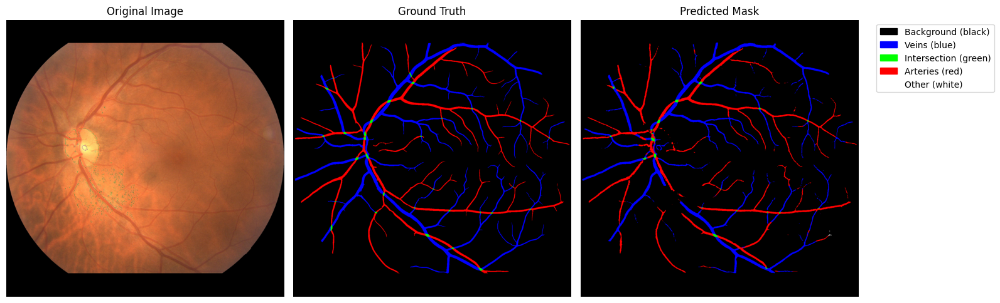

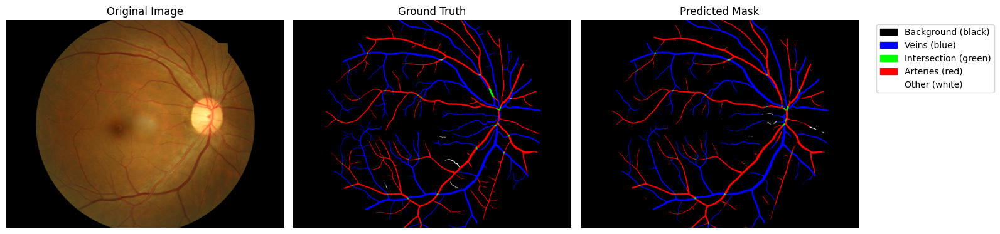

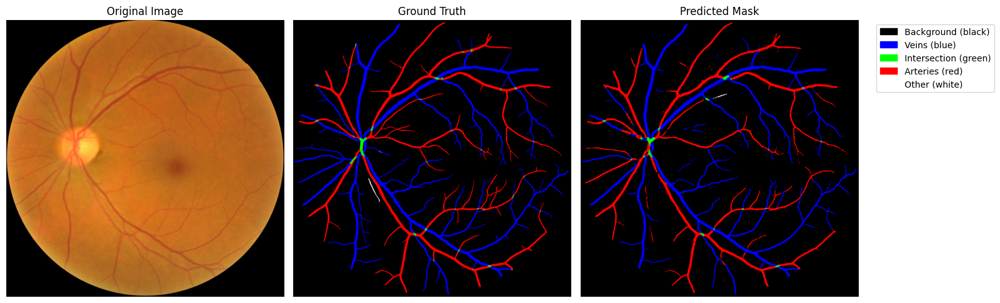

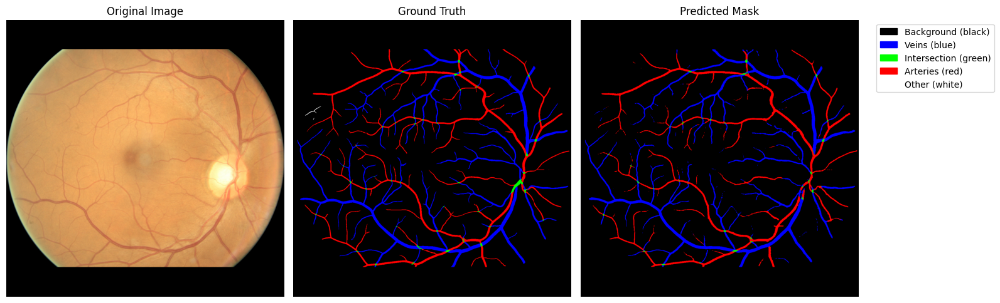

...

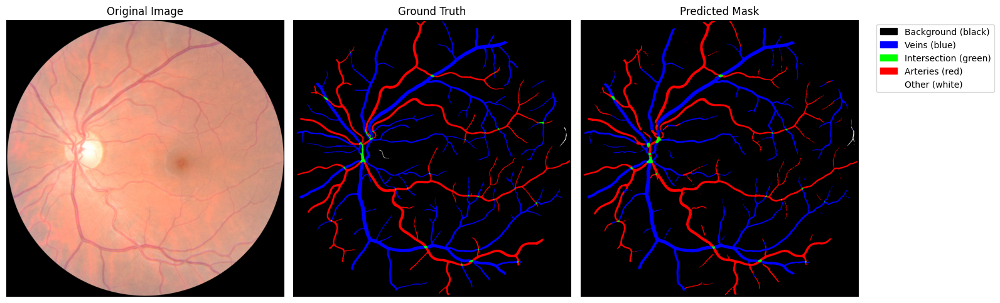

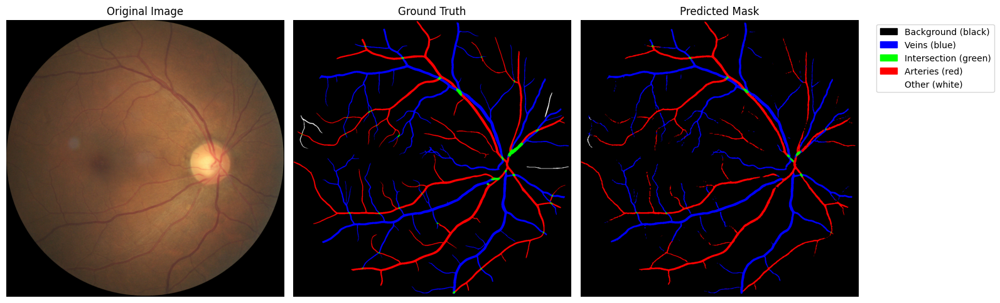

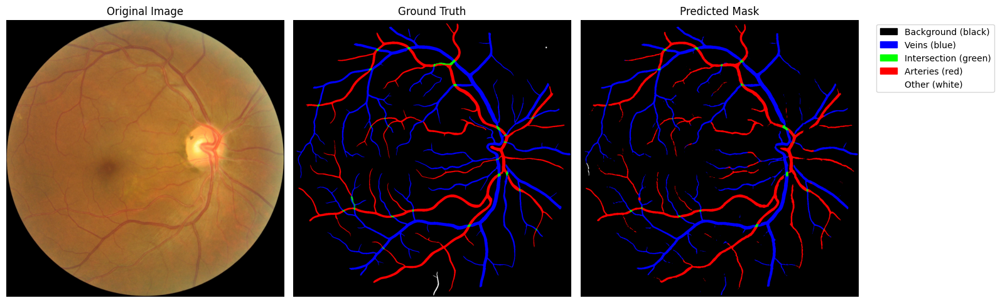

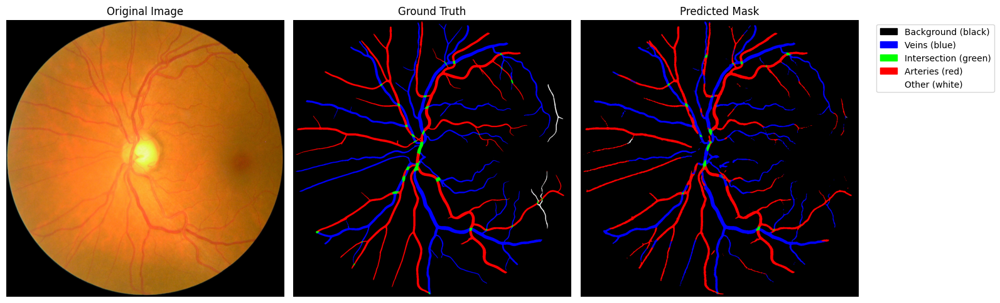

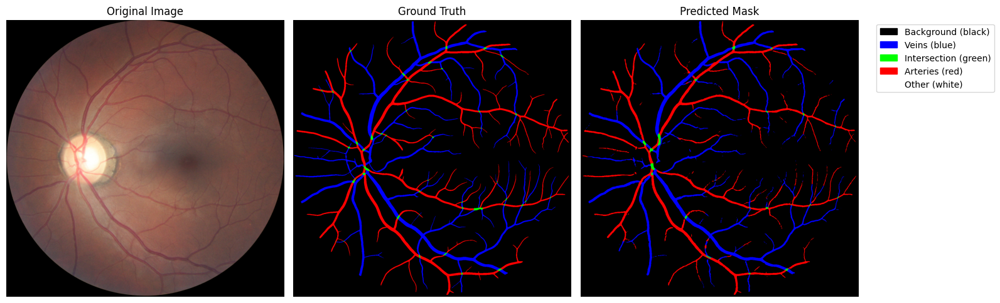


--- Average metrics ---
Class 0 (Background (black)): Dice = 0.9914, IoU = 0.9830
Class 1 (Veins (blue)): Dice = 0.8702, IoU = 0.7713
Class 2 (Intersection (green)): Dice = 0.4933, IoU = 0.3306
Class 3 (Arteries (red)): Dice = 0.8457, IoU = 0.7334
Class 4 (Other (white)): Dice = 0.0452, IoU = 0.0268

Mean Dice: 0.6491, Mean IoU: 0.5690


In [ ]:
import os
import numpy as np
from PIL import Image
import torch
import torch.nn.functional as F
from transformers import SegformerFeatureExtractor, SegformerForSemanticSegmentation
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches


device = torch.device("cpu")
model_path = r"D:\aspirantura\SegFormer\SegFormer-Fundus-AVSeg\segformer-fold5\best_model"
test_list_path = r"D:\aspirantura\segmentation\testing.txt"
image_dir = r"D:\aspirantura\segmentation\images"
mask_dir = r"D:\aspirantura\segmentation\annotation"

patch_size = 512
stride = 256
num_classes = 5
unique_colors = [[0,0,0],[0,0,255],[0,255,0],[255,0,0],[255,255,255]]  # black, blue, green, red, white


def load_images_masks(file_list):
    images_mem, masks_mem = [], []
    for file_name in file_list:
        img_path = os.path.join(image_dir, file_name)
        mask_path = os.path.join(mask_dir, file_name)
        img = np.array(Image.open(img_path).convert("RGB"))
        mask = np.array(Image.open(mask_path))
        mask_class = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.int64)
        for i, color in enumerate(unique_colors):
            mask_class[np.all(mask == color, axis=-1)] = i
        images_mem.append(img)
        masks_mem.append(mask_class)
    return images_mem, masks_mem


def mask_to_rgb(mask, colors):
    h, w = mask.shape
    rgb = np.zeros((h, w, 3), dtype=np.uint8)
    for i, c in enumerate(colors):
        rgb[mask == i] = c
    return rgb


def dice_metric(pred, target, class_idx):
    pred_mask = (pred == class_idx)
    target_mask = (target == class_idx)
    intersection = np.logical_and(pred_mask, target_mask).sum()
    return 2 * intersection / (pred_mask.sum() + target_mask.sum() + 1e-6)


def iou_metric(pred, target, class_idx):
    pred_mask = (pred == class_idx)
    target_mask = (target == class_idx)
    intersection = np.logical_and(pred_mask, target_mask).sum()
    union = np.logical_or(pred_mask, target_mask).sum()
    return intersection / (union + 1e-6)



# Загрузка списка тестовых файлов

with open(test_list_path, "r") as f:
    test_files = [line.strip() for line in f.readlines()]

test_images_mem, test_masks_mem = load_images_masks(test_files)


# Загрузка модели

feature_extractor = SegformerFeatureExtractor(reduce_labels=False)
model = SegformerForSemanticSegmentation.from_pretrained(
    model_path,
    num_labels=num_classes,
    id2label={i: str(i) for i in range(num_classes)},
    label2id={str(i): i for i in range(num_classes)},
    ignore_mismatched_sizes=True
).to(device)
model.eval()


# Функция предсказания

def predict_full_image(model, img, patch_size=512, stride=256):
    h, w, _ = img.shape
    full_probs = np.zeros((h, w, num_classes), dtype=np.float32)
    count_mask = np.zeros((h, w, num_classes), dtype=np.float32)

    for i in range(0, h, stride):
        for j in range(0, w, stride):
            i_end = min(i + patch_size, h)
            j_end = min(j + patch_size, w)
            patch = img[i:i_end, j:j_end]

            encoding = feature_extractor(images=Image.fromarray(patch), return_tensors="pt")
            inputs = {k: v.to(device) for k, v in encoding.items()}

            with torch.no_grad():
                logits = model(**inputs).logits
                logits = F.interpolate(logits, size=(i_end - i, j_end - j), mode="bilinear", align_corners=False)
                probs = torch.softmax(logits, dim=1).squeeze().cpu().numpy().transpose(1, 2, 0)

            full_probs[i:i_end, j:j_end, :] += probs
            count_mask[i:i_end, j:j_end, :] += 1

    full_probs /= np.maximum(count_mask, 1e-6)
    final_mask = np.argmax(full_probs, axis=-1)
    return final_mask



# Тестирование и визуализация

all_dice, all_iou = [], []

class_labels = {
    0: "Background (black)",
    1: "Veins (blue)",
    2: "Intersection (green)",
    3: "Arteries (red)",
    4: "Other (white)"
}

for img, mask_class in zip(test_images_mem, test_masks_mem):
    pred_mask = predict_full_image(model, img, patch_size=patch_size, stride=stride)

    # RGB маски
    gt_rgb = mask_to_rgb(mask_class, unique_colors)
    pred_rgb = mask_to_rgb(pred_mask, unique_colors)

    # Метрики
    dice_vals = [dice_metric(pred_mask, mask_class, c) for c in range(num_classes)]
    iou_vals = [iou_metric(pred_mask, mask_class, c) for c in range(num_classes)]
    all_dice.append(dice_vals)
    all_iou.append(iou_vals)

    # Визуализация
    plt.figure(figsize=(16, 6))
    plt.subplot(1, 3, 1)
    plt.title("Original Image")
    plt.imshow(img)
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.title("Ground Truth")
    plt.imshow(gt_rgb)
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.title("Predicted Mask")
    plt.imshow(pred_rgb)
    plt.axis("off")

    patches = [mpatches.Patch(color=np.array(unique_colors[i]) / 255.0, label=f"{class_labels[i]}")
               for i in range(num_classes)]
    plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc="upper left")
    plt.tight_layout()
    plt.show()


# Средние метрики

all_dice = np.array(all_dice)
all_iou = np.array(all_iou)

print("\n--- Average metrics ---")
for c in range(num_classes):
    print(f"Class {c} ({class_labels[c]}): Dice = {all_dice[:, c].mean():.4f}, IoU = {all_iou[:, c].mean():.4f}")

print(f"\nMean Dice: {all_dice.mean():.4f}, Mean IoU: {all_iou.mean():.4f}")


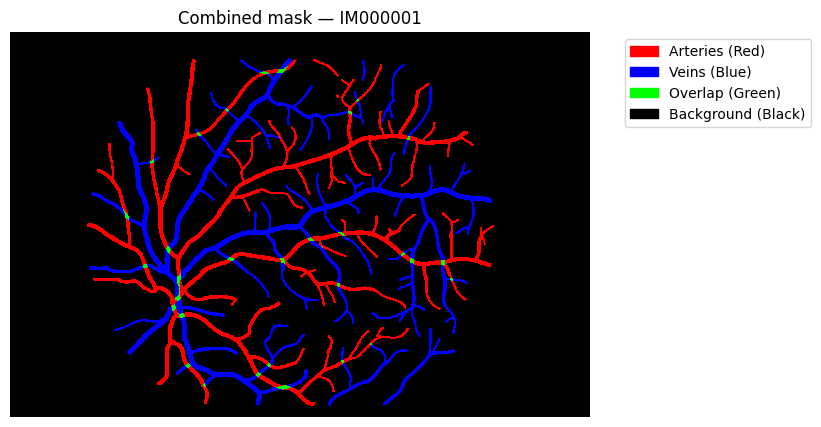

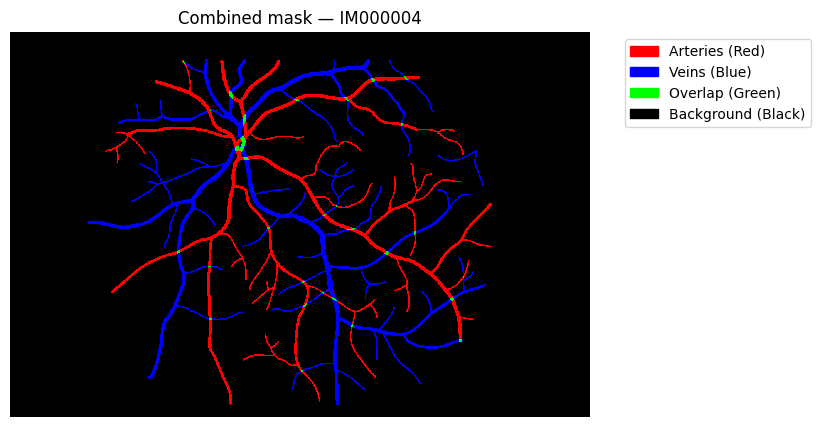

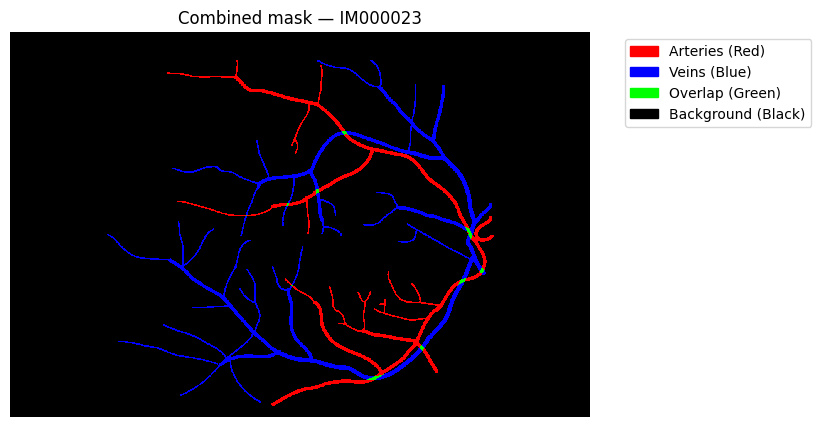

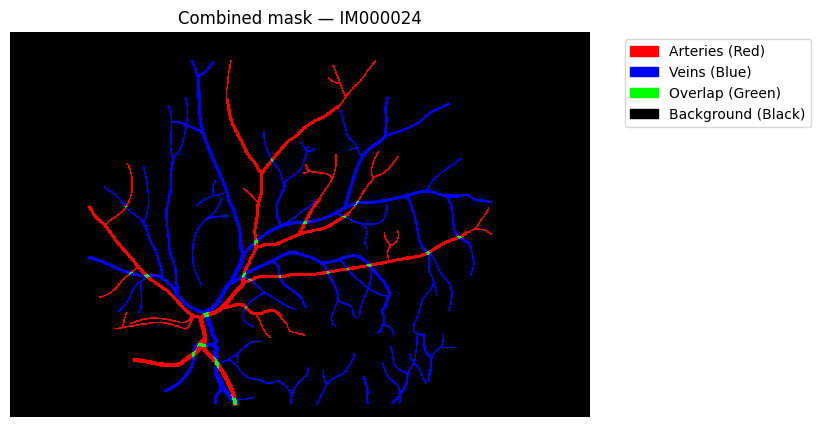

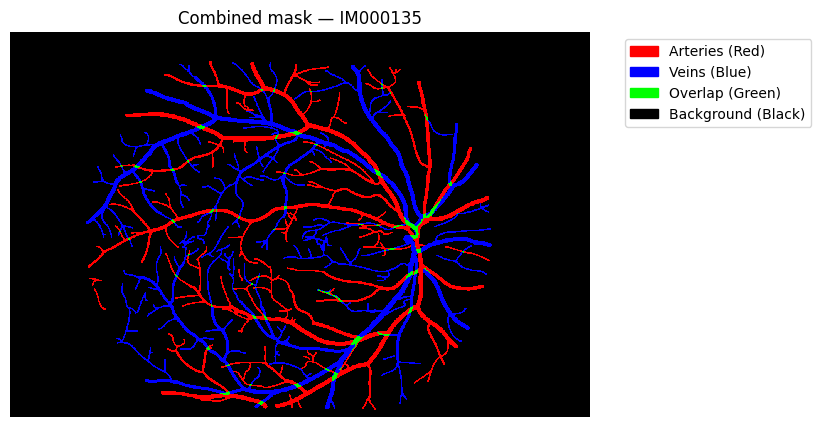

...

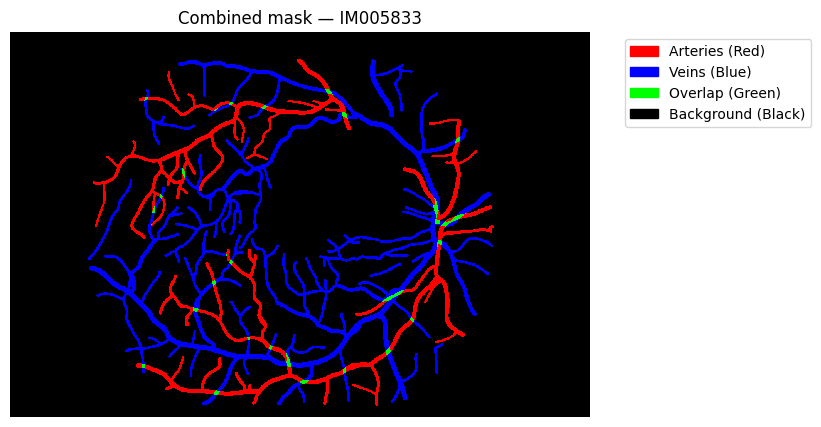

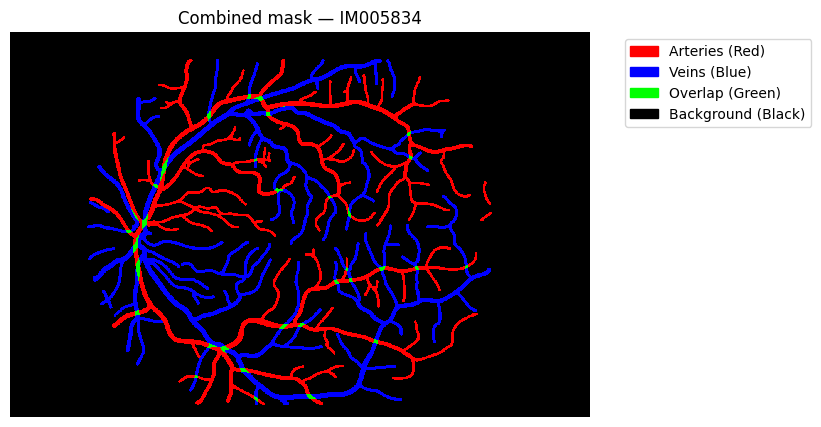

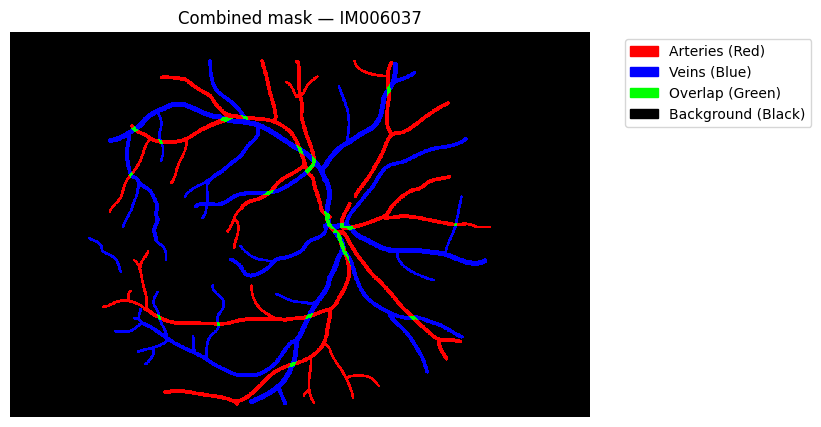

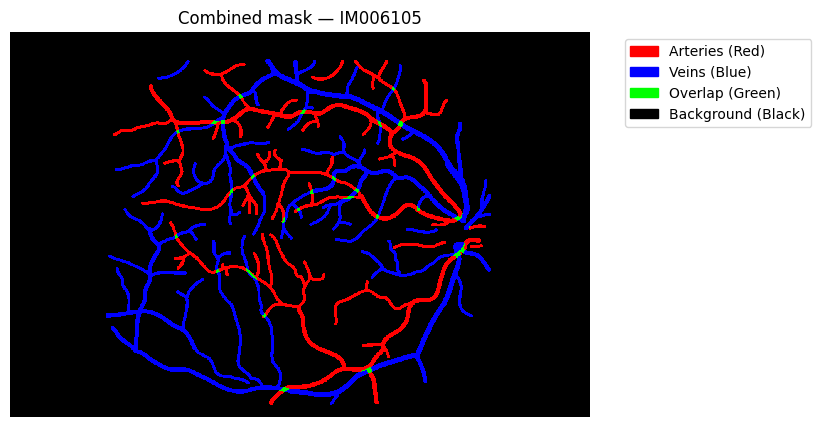

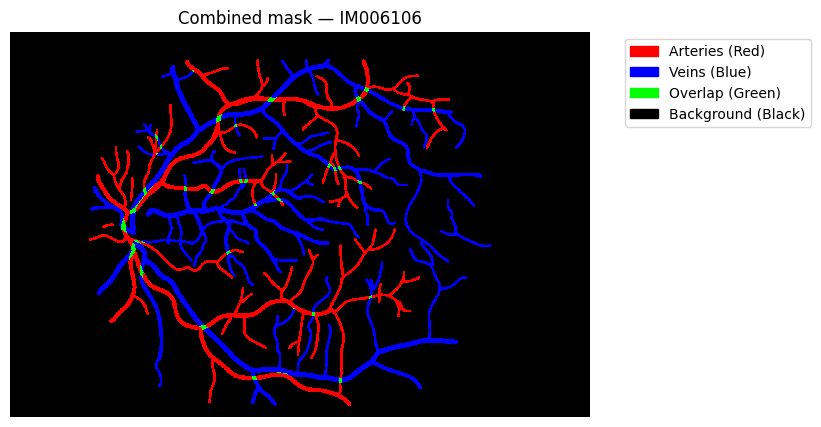

Не найдено изображение для combined_masks
Не найдено изображение для combined_masks_1
Не найдено изображение для original_images
Не найдено изображение для original_images_1


In [11]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

# ---------- Пути ----------
base_dir = r"D:\aspirantura\SegFormer\AV"  # корневая папка с IM000001 и т.д.
output_images_dir = os.path.join(base_dir, "original_images_1")
output_masks_dir  = os.path.join(base_dir, "combined_masks_1")

os.makedirs(output_images_dir, exist_ok=True)
os.makedirs(output_masks_dir, exist_ok=True)

# ---------- Возможные шаблоны для поиска масок ----------
artery_patterns = ["--a", "-a", "art", "artery", "arteries"]
vein_patterns   = ["vei", "vein", "veins", "vai"]

# ---------- Функция поиска масок ----------
def find_mask_path(folder, case_name, patterns):
    for fname in os.listdir(folder):
        low = fname.lower()
        if not low.startswith(case_name.lower()):
            continue
        if any(pat in low for pat in patterns):
            return os.path.join(folder, fname)
    return None

# ---------- Функция бинаризации и очистки ----------
def preprocess_mask(mask):
    gray = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)
    gray = cv2.medianBlur(gray, 3)
    _, binary = cv2.threshold(gray, 240, 255, cv2.THRESH_BINARY_INV)
    kernel = np.ones((3, 3), np.uint8)
    binary = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel)
    binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)
    return binary.astype(bool)

# ---------- Основной цикл ----------
for case_folder in sorted(os.listdir(base_dir)):
    folder_path = os.path.join(base_dir, case_folder)
    if not os.path.isdir(folder_path):
        continue

    # ---------- Поиск масок ----------
    artery_path = find_mask_path(folder_path, case_folder, artery_patterns)
    vein_path   = find_mask_path(folder_path, case_folder, vein_patterns)

    # ---------- Поиск оригинального изображения ----------
    img_path = None
    for fname in os.listdir(folder_path):
        if fname.lower().startswith(case_folder.lower()) and fname.lower().endswith(".jpg"):
            img_path = os.path.join(folder_path, fname)
            break
    if not img_path:
        print(f"Не найдено изображение для {case_folder}")
        continue

    # ---------- Загрузка ----------
    img = cv2.imread(img_path)
    artery_mask = cv2.imread(artery_path, cv2.IMREAD_COLOR) if artery_path else None
    vein_mask   = cv2.imread(vein_path, cv2.IMREAD_COLOR)   if vein_path else None

    h, w = img.shape[:2]

    # ---------- Создаём черный фон ----------
    combined = np.zeros((h, w, 3), dtype=np.uint8)  # черный фон

    # ---------- Бинаризация и очистка ----------
    artery_binary = preprocess_mask(artery_mask) if artery_mask is not None else np.zeros((h, w), bool)
    vein_binary   = preprocess_mask(vein_mask)   if vein_mask is not None else np.zeros((h, w), bool)
    overlap = artery_binary & vein_binary

    # ---------- Наложение масок ----------
    combined[artery_binary & ~overlap] = [255, 0, 0]   # красный
    combined[vein_binary & ~overlap]   = [0, 0, 255]   # синий
    combined[overlap]                  = [0, 255, 0]   # зеленый

    # ---------- Сохраняем ----------
    img_out_path = os.path.join(output_images_dir, f"{case_folder}.jpg")
    mask_out_path = os.path.join(output_masks_dir, f"{case_folder}_mask.png")

    cv2.imwrite(img_out_path, img)
    cv2.imwrite(mask_out_path, cv2.cvtColor(combined, cv2.COLOR_RGB2BGR))  # OpenCV сохраняет BGR

    # ---------- Визуализация ----------
    plt.figure(figsize=(10, 5))
    plt.imshow(combined, interpolation='nearest')
    plt.title(f"Combined mask — {case_folder}")
    plt.axis("off")
    patches = [
        mpatches.Patch(color=np.array([255,0,0])/255, label='Arteries (Red)'),
        mpatches.Patch(color=np.array([0,0,255])/255, label='Veins (Blue)'),
        mpatches.Patch(color=np.array([0,255,0])/255, label='Overlap (Green)'),
        mpatches.Patch(color=np.array([0,0,0])/255, label='Background (Black)')
    ]
    plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()


# тестирование нового датасета

d:\aspirantura\SegFormer\SegFormer-Fundus-AVSeg\.venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
d:\aspirantura\SegFormer\SegFormer-Fundus-AVSeg\.venv\lib\site-packages\transformers\models\segformer\feature_extraction_segformer.py:28: FutureWarning: The class SegformerFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use SegformerImageProcessor instead.
  warnings.warn(


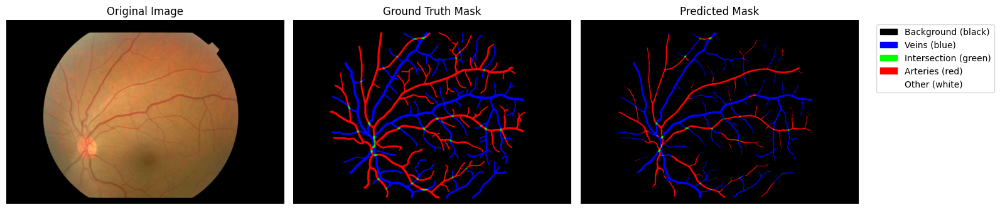

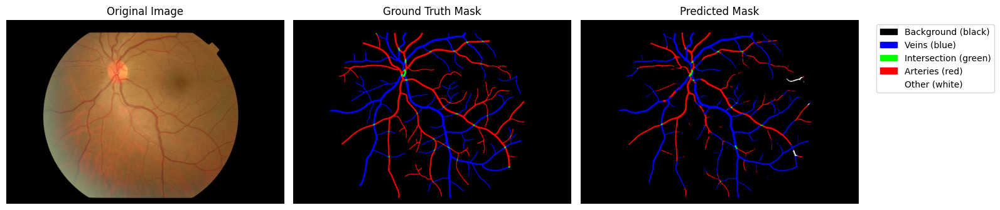

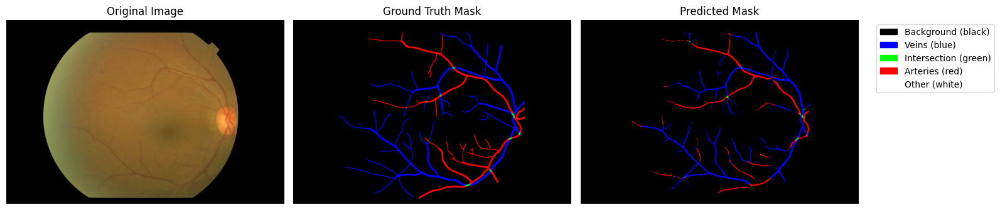

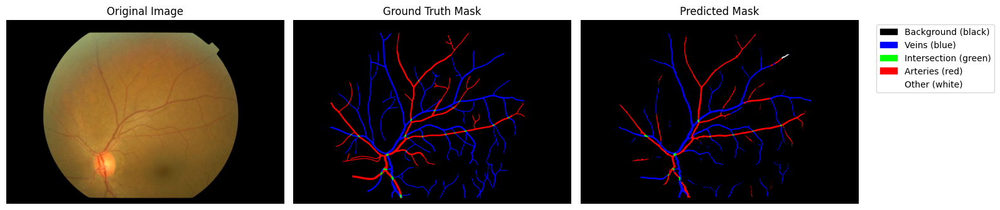

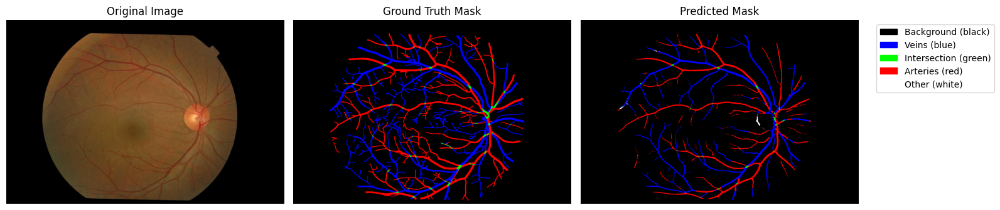

...

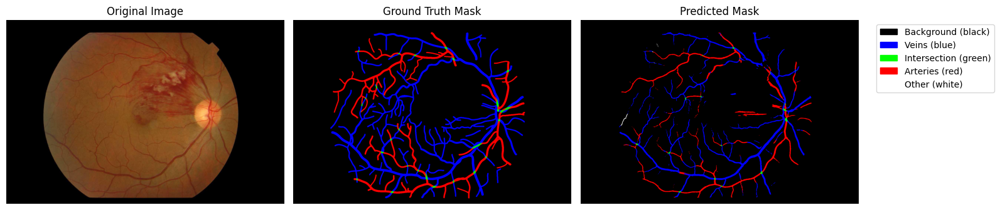

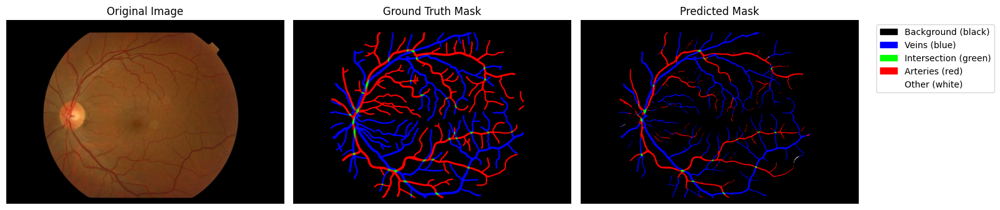

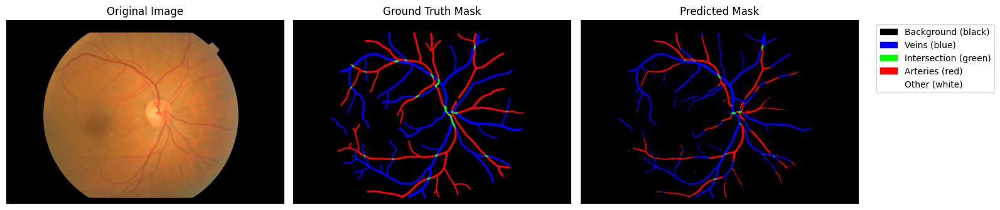

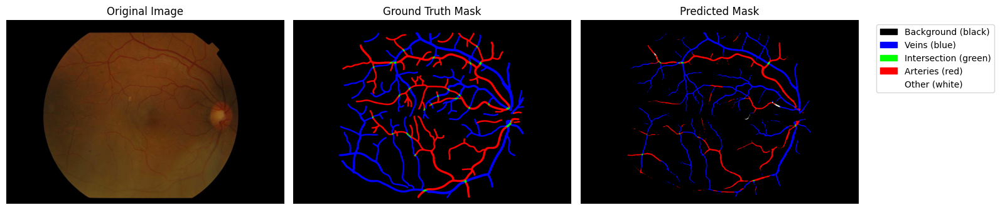

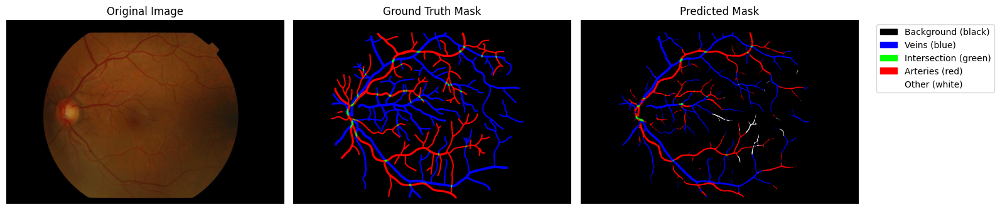


--- Average metrics ---
Class 0 (Background (black)): Dice = 0.9731, IoU = 0.9477
Class 1 (Veins (blue)): Dice = 0.5855, IoU = 0.4177
Class 2 (Intersection (green)): Dice = 0.3000, IoU = 0.1799
Class 3 (Arteries (red)): Dice = 0.4950, IoU = 0.3335
Class 4 (Other (white)): Dice = 0.0000, IoU = 0.0000

Mean Dice: 0.4707, Mean IoU: 0.3758


In [ ]:
import os
import numpy as np
from PIL import Image
import torch
from torch.nn import functional as F
from transformers import SegformerFeatureExtractor, SegformerForSemanticSegmentation
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches


device = torch.device("cpu")
model_path = r"D:\aspirantura\SegFormer\SegFormer-Fundus-AVSeg\segformer-fold5\best_model"

# Папки
image_dir = r"D:\aspirantura\SegFormer\AV\original_images"   # оригинальные изображения глаза (.JPG)
mask_dir  = r"D:\aspirantura\SegFormer\AV\combined_masks"    # комбинированные маски (_mask.png)

patch_size = 512
stride = 256
num_classes = 5
unique_colors = [[0,0,0],[0,0,255],[0,255,0],[255,0,0],[255,255,255]]  # black, blue, green, red, white


def load_images_masks(file_list):
    images_mem, masks_mem = [], []
    for file_name in file_list:
        # оригинальное изображение
        img_path = os.path.join(image_dir, file_name + ".JPG")
        # маска
        mask_path = os.path.join(mask_dir, file_name + "_mask.png")

        if not os.path.exists(img_path) or not os.path.exists(mask_path):
            print(f"Пропущено {file_name}: файл не найден")
            continue

        img = np.array(Image.open(img_path).convert("RGB"))
        mask = np.array(Image.open(mask_path))

        mask_class = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.int64)
        for i, color in enumerate(unique_colors):
            mask_class[np.all(mask == color, axis=-1)] = i

        images_mem.append(img)
        masks_mem.append(mask_class)
    return images_mem, masks_mem

def mask_to_rgb(mask, colors):
    h, w = mask.shape
    rgb = np.zeros((h, w, 3), dtype=np.uint8)
    for i, c in enumerate(colors):
        rgb[mask == i] = c
    return rgb

def dice_metric(pred, target, class_idx):
    pred_mask = (pred == class_idx)
    target_mask = (target == class_idx)
    intersection = np.logical_and(pred_mask, target_mask).sum()
    return 2 * intersection / (pred_mask.sum() + target_mask.sum() + 1e-6)

def iou_metric(pred, target, class_idx):
    pred_mask = (pred == class_idx)
    target_mask = (target == class_idx)
    intersection = np.logical_and(pred_mask, target_mask).sum()
    union = np.logical_or(pred_mask, target_mask).sum()
    return intersection / (union + 1e-6)


# Здесь предполагается, что в папке original_images лежат файлы IM000001.JPG, IM000002.JPG и т.д.
test_files = [os.path.splitext(f)[0] for f in os.listdir(image_dir) if f.lower().endswith(".jpg")]

test_images_mem, test_masks_mem = load_images_masks(test_files)


feature_extractor = SegformerFeatureExtractor(reduce_labels=False)
model = SegformerForSemanticSegmentation.from_pretrained(
    model_path,
    num_labels=num_classes,
    id2label={i: str(i) for i in range(num_classes)},
    label2id={str(i): i for i in range(num_classes)},
    ignore_mismatched_sizes=True
).to(device)
model.eval()


def predict_full_image(model, img, patch_size=512, stride=256):
    h, w, _ = img.shape
    full_probs = np.zeros((h, w, num_classes), dtype=np.float32)
    count_mask = np.zeros((h, w, num_classes), dtype=np.float32)

    for i in range(0, h, stride):
        for j in range(0, w, stride):
            i_end = min(i + patch_size, h)
            j_end = min(j + patch_size, w)
            patch = img[i:i_end, j:j_end]

            encoding = feature_extractor(images=Image.fromarray(patch), return_tensors="pt")
            inputs = {k: v.to(device) for k, v in encoding.items()}

            with torch.no_grad():
                logits = model(**inputs).logits
                logits = F.interpolate(logits, size=(i_end - i, j_end - j), mode="bilinear", align_corners=False)
                probs = torch.softmax(logits, dim=1).squeeze().cpu().numpy().transpose(1, 2, 0)

            full_probs[i:i_end, j:j_end, :] += probs
            count_mask[i:i_end, j:j_end, :] += 1

    full_probs /= np.maximum(count_mask, 1e-6)
    final_mask = np.argmax(full_probs, axis=-1)
    return final_mask


all_dice, all_iou = [], []

class_labels = {
    0: "Background (black)",
    1: "Veins (blue)",
    2: "Intersection (green)",
    3: "Arteries (red)",
    4: "Other (white)"
}

for img, mask_class in zip(test_images_mem, test_masks_mem):
    pred_mask = predict_full_image(model, img, patch_size=patch_size, stride=stride)

    gt_rgb = mask_to_rgb(mask_class, unique_colors)
    pred_rgb = mask_to_rgb(pred_mask, unique_colors)

    dice_vals = [dice_metric(pred_mask, mask_class, c) for c in range(num_classes)]
    iou_vals = [iou_metric(pred_mask, mask_class, c) for c in range(num_classes)]
    all_dice.append(dice_vals)
    all_iou.append(iou_vals)

    plt.figure(figsize=(16, 6))
    plt.subplot(1, 3, 1)
    plt.title("Original Image")
    plt.imshow(img)
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.title("Ground Truth Mask")
    plt.imshow(gt_rgb)
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.title("Predicted Mask")
    plt.imshow(pred_rgb)
    plt.axis("off")

    patches = [mpatches.Patch(color=np.array(unique_colors[i]) / 255.0, label=f"{class_labels[i]}")
               for i in range(num_classes)]
    plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()


all_dice = np.array(all_dice)
all_iou = np.array(all_iou)

print("\n--- Average metrics ---")
for c in range(num_classes):
    print(f"Class {c} ({class_labels[c]}): Dice = {all_dice[:, c].mean():.4f}, IoU = {all_iou[:, c].mean():.4f}")

print(f"\nMean Dice: {all_dice.mean():.4f}, Mean IoU: {all_iou.mean():.4f}")
